Epoch 1/50


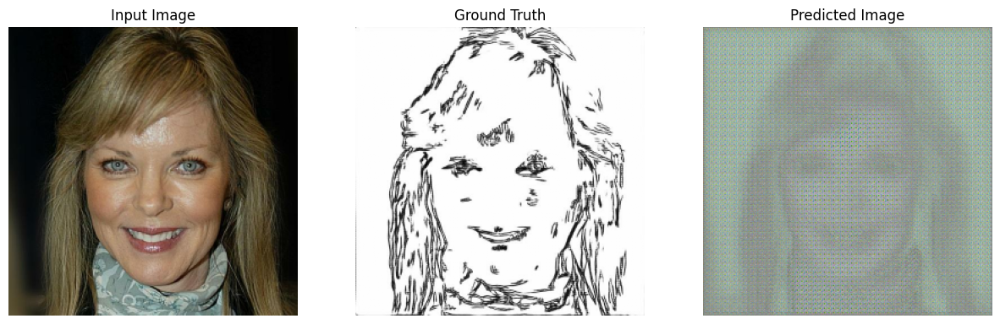

Time taken for epoch 1: 219.92750144004822 sec

Epoch 2/50


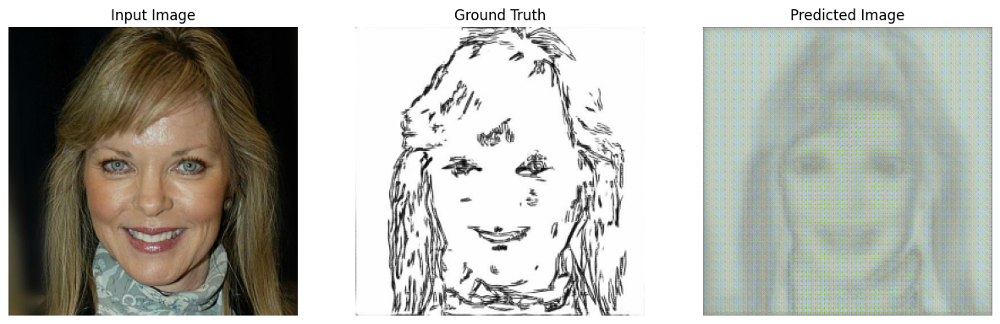

Time taken for epoch 2: 161.88993740081787 sec

Epoch 3/50


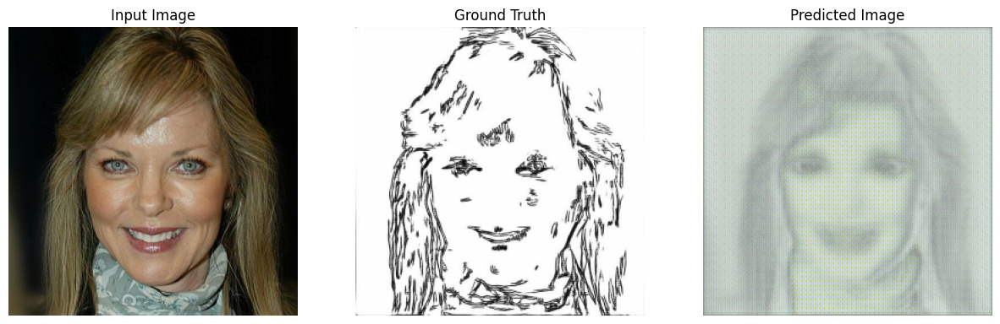

Time taken for epoch 3: 159.69647884368896 sec

Epoch 4/50


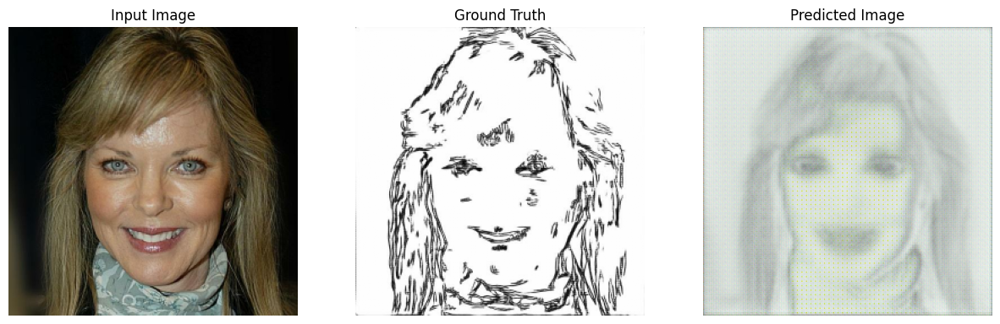

Time taken for epoch 4: 162.74234175682068 sec

Epoch 5/50


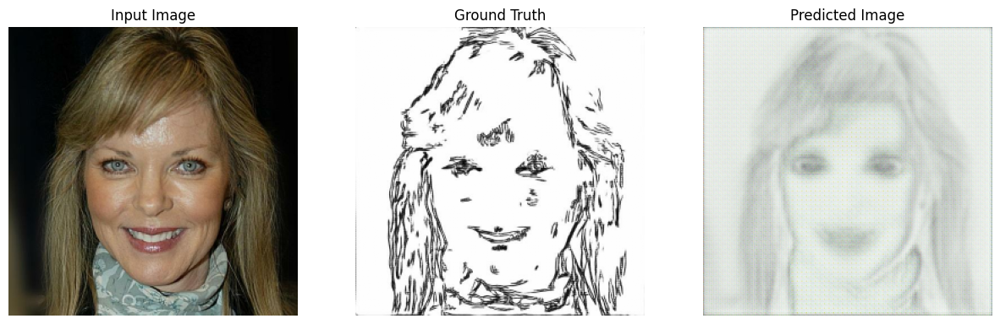

Time taken for epoch 5: 161.94767999649048 sec

Epoch 6/50


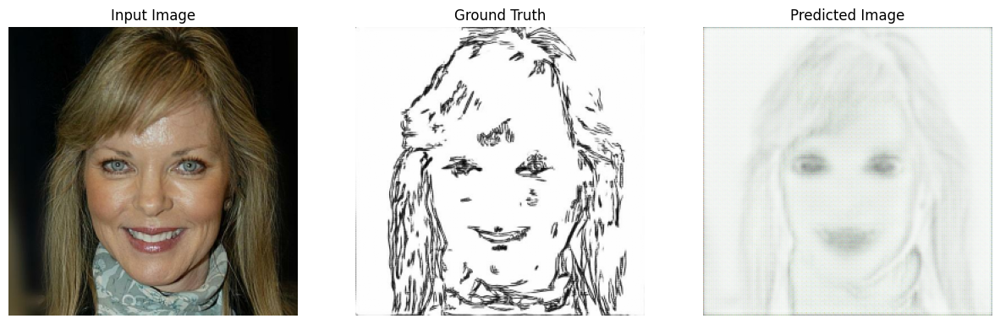

Time taken for epoch 6: 162.72309947013855 sec

Epoch 7/50


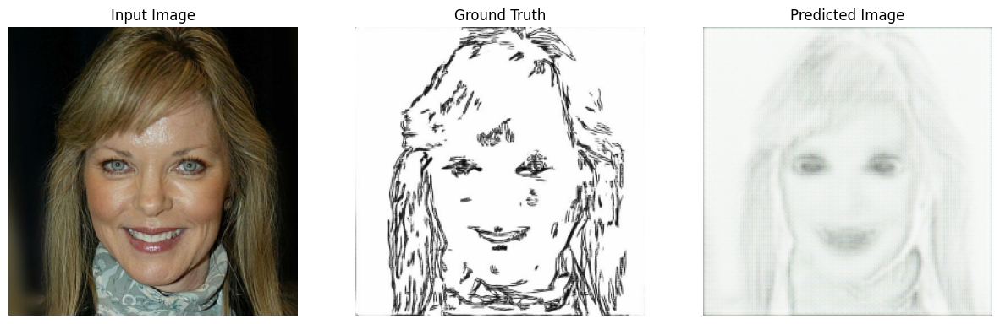

Time taken for epoch 7: 159.1281304359436 sec

Epoch 8/50


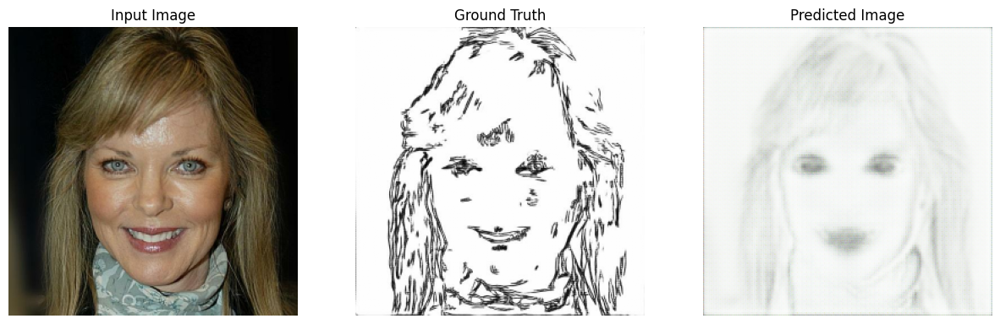

Time taken for epoch 8: 160.73658990859985 sec

Epoch 9/50


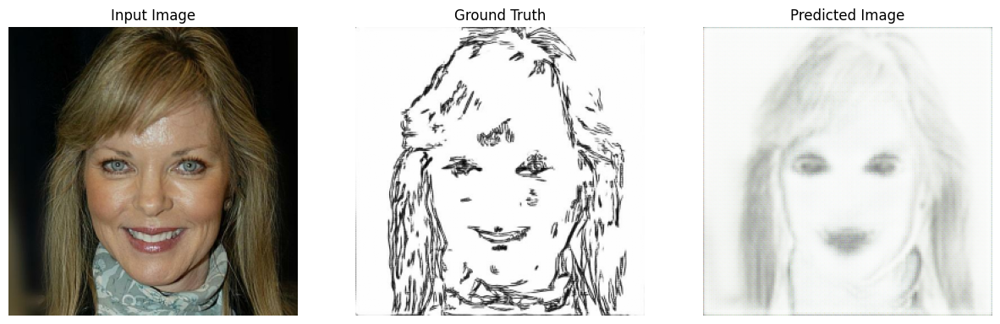

Time taken for epoch 9: 161.40287375450134 sec

Epoch 10/50


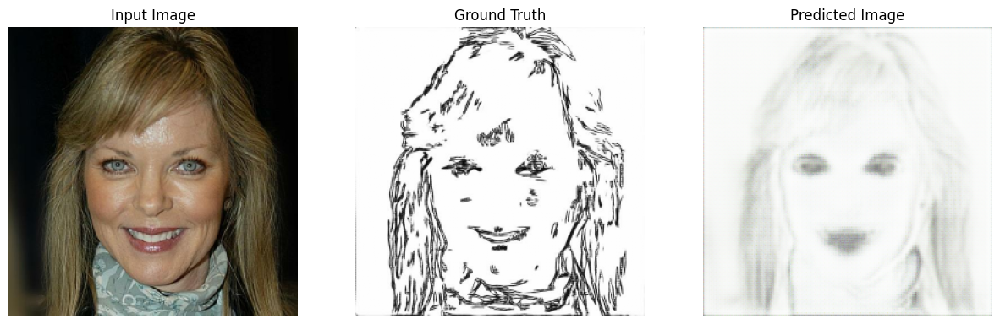

Time taken for epoch 10: 160.74726605415344 sec

Epoch 11/50


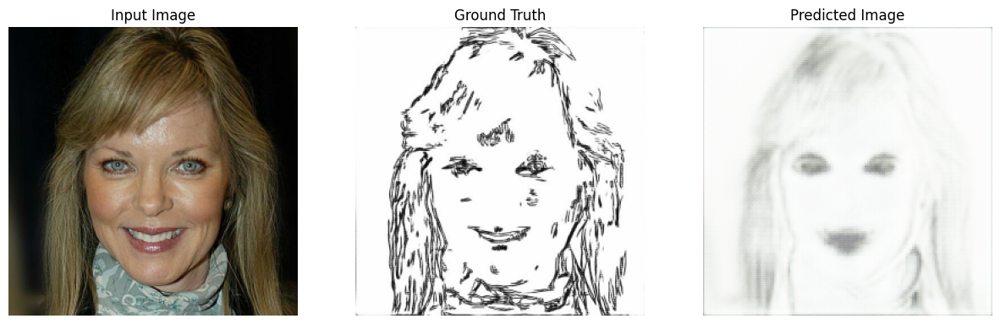

Time taken for epoch 11: 161.63905715942383 sec

Epoch 12/50


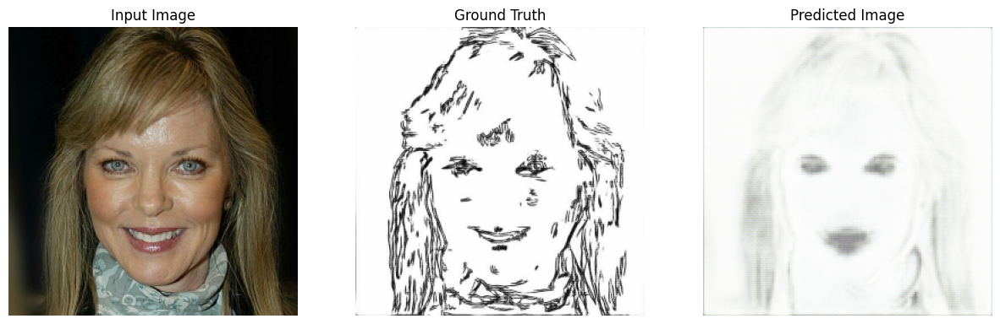

Time taken for epoch 12: 163.09092330932617 sec

Epoch 13/50


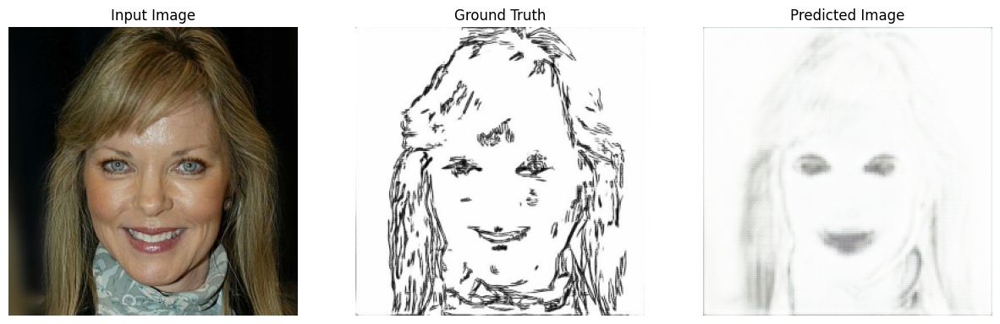

Time taken for epoch 13: 161.55391335487366 sec

Epoch 14/50


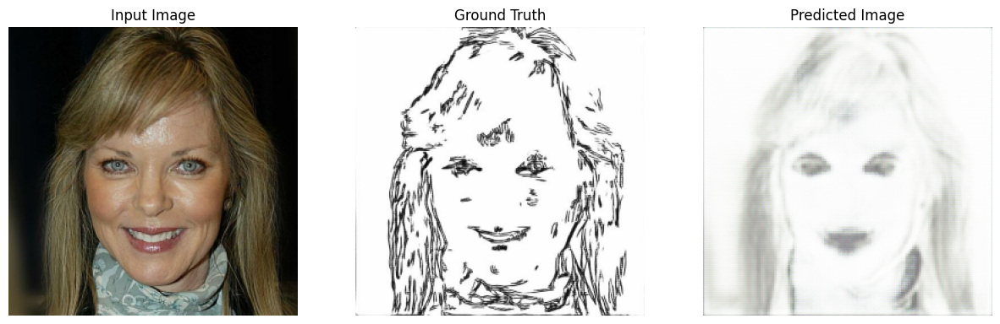

Time taken for epoch 14: 159.96735644340515 sec

Epoch 15/50


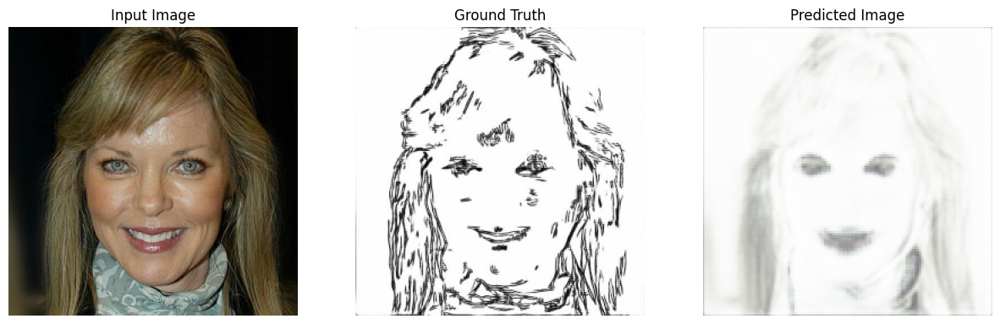

Time taken for epoch 15: 162.38099098205566 sec

Epoch 16/50


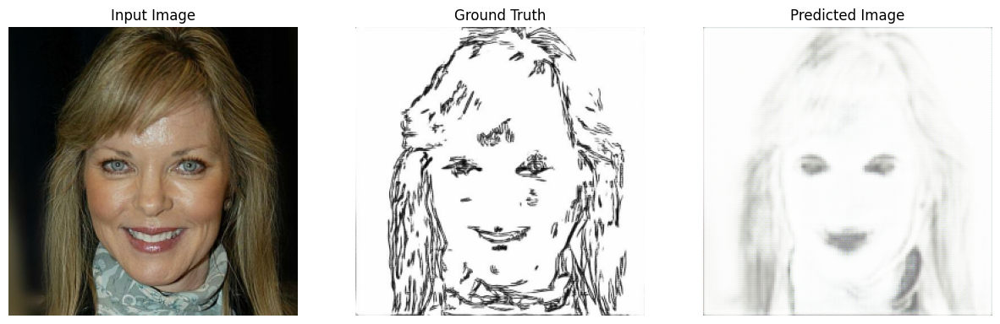

Time taken for epoch 16: 160.96795058250427 sec

Epoch 17/50


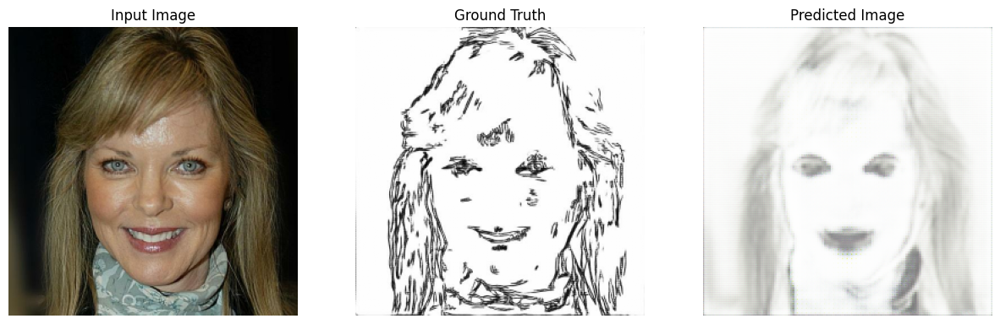

Time taken for epoch 17: 159.85790252685547 sec

Epoch 18/50


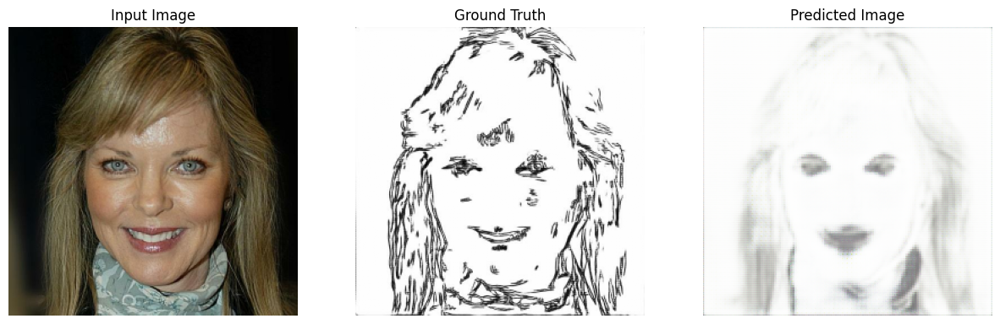

Time taken for epoch 18: 160.24713015556335 sec

Epoch 19/50


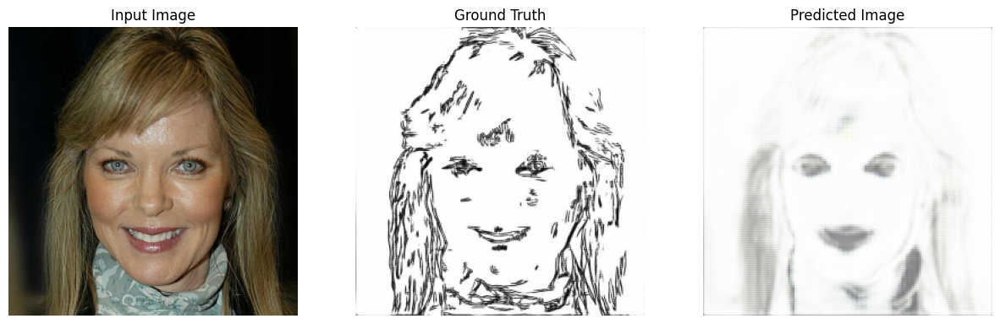

Time taken for epoch 19: 161.07574939727783 sec

Epoch 20/50


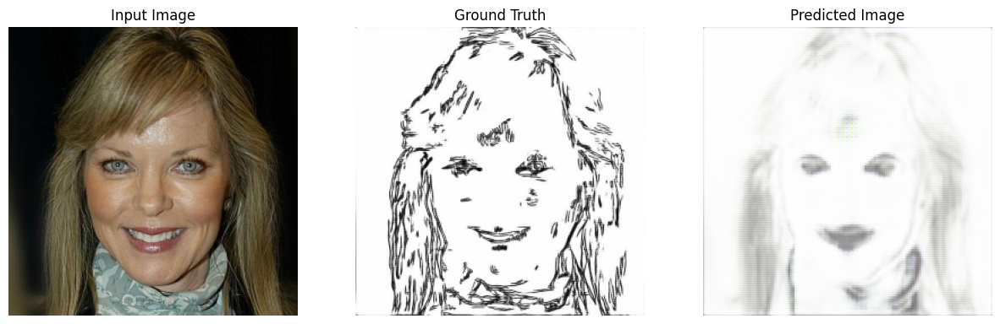

Time taken for epoch 20: 161.59703159332275 sec

Epoch 21/50


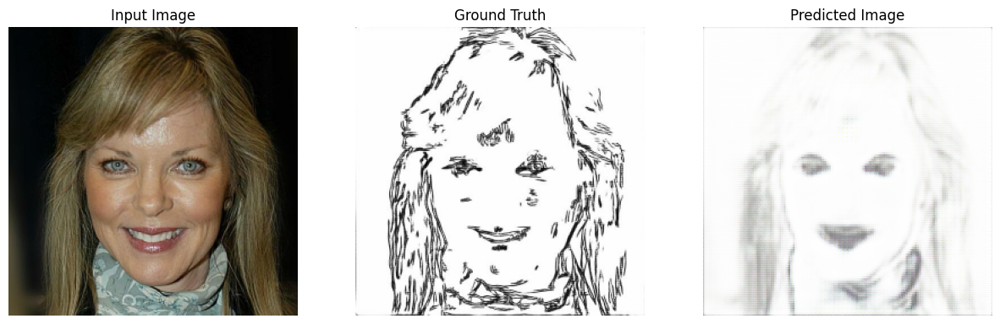

Time taken for epoch 21: 163.91164779663086 sec

Epoch 22/50


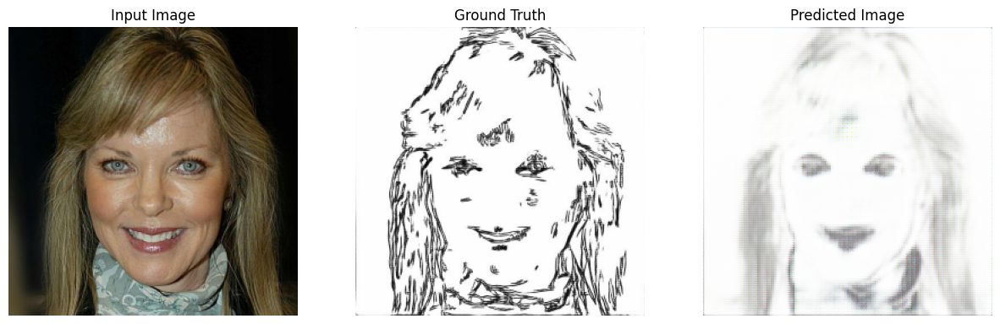

Time taken for epoch 22: 162.68131971359253 sec

Epoch 23/50


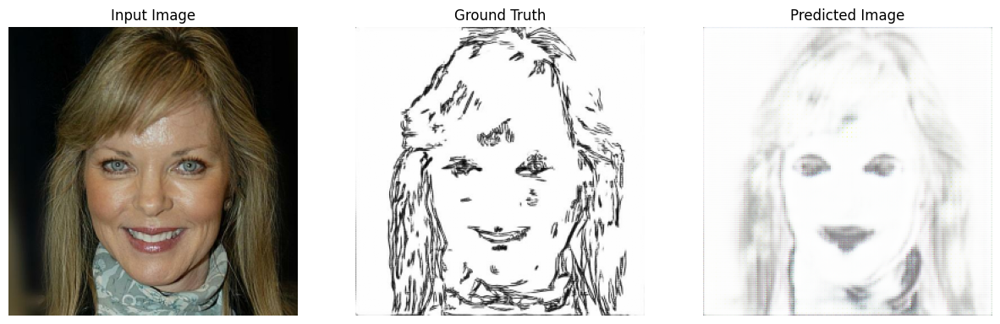

Time taken for epoch 23: 160.17605018615723 sec

Epoch 24/50


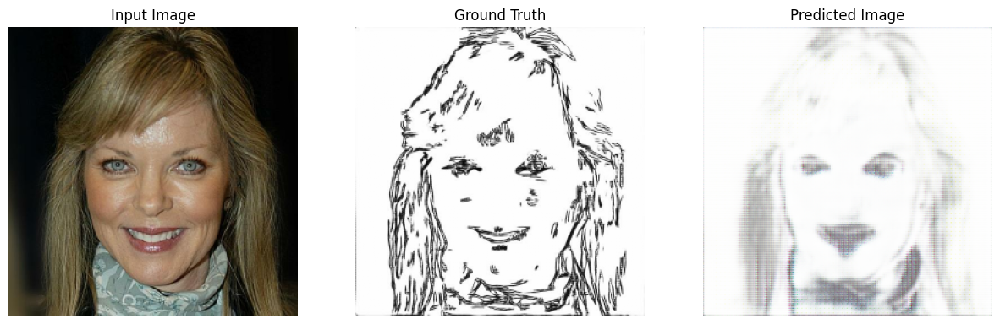

Time taken for epoch 24: 160.19360375404358 sec

Epoch 25/50


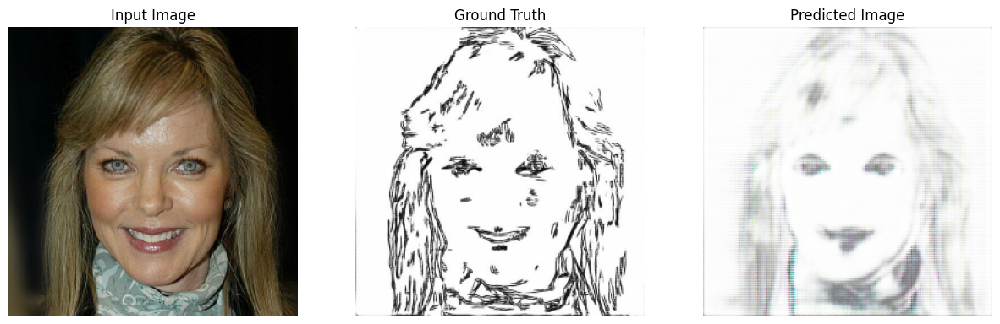

Time taken for epoch 25: 159.47330021858215 sec

Epoch 26/50


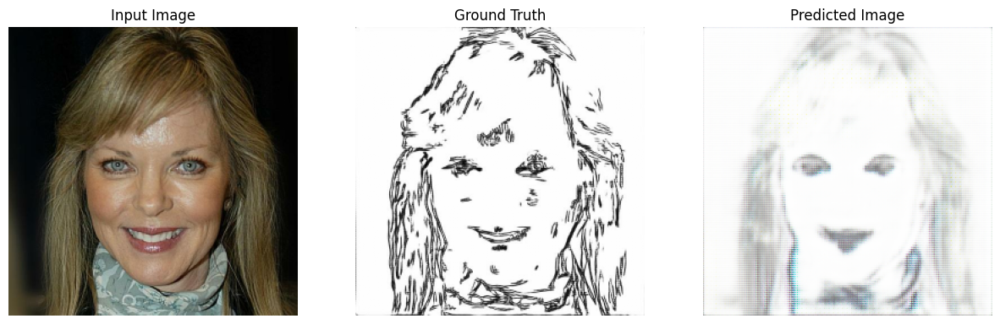

Time taken for epoch 26: 161.19824886322021 sec

Epoch 27/50


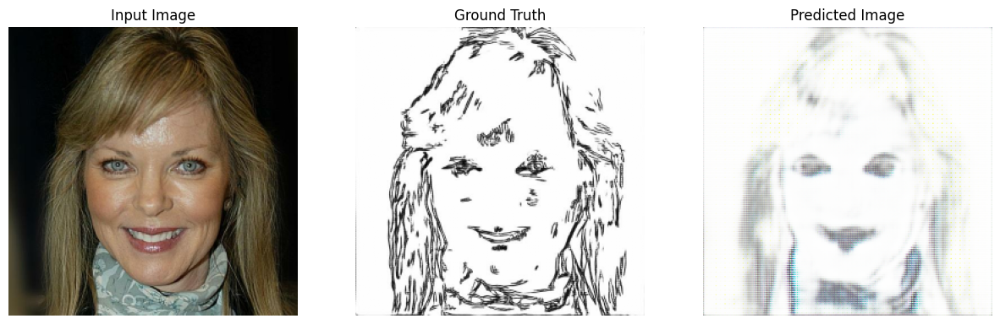

Time taken for epoch 27: 160.31252884864807 sec

Epoch 28/50


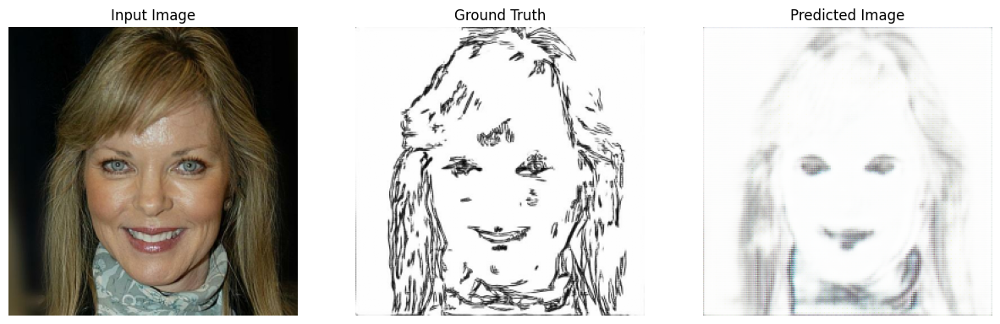

Time taken for epoch 28: 159.98643684387207 sec

Epoch 29/50


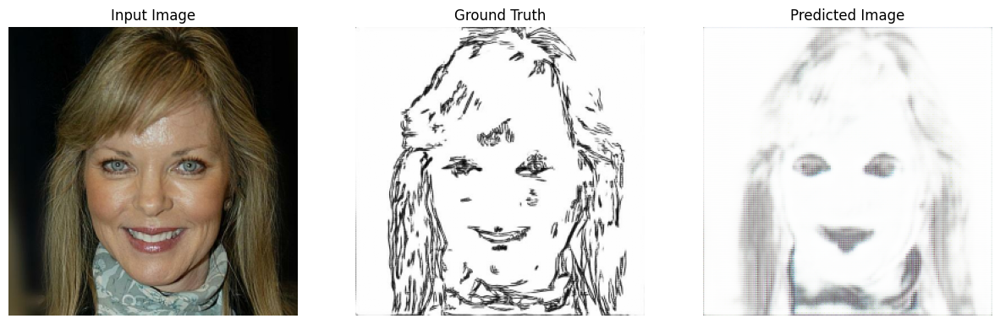

Time taken for epoch 29: 162.23504519462585 sec

Epoch 30/50


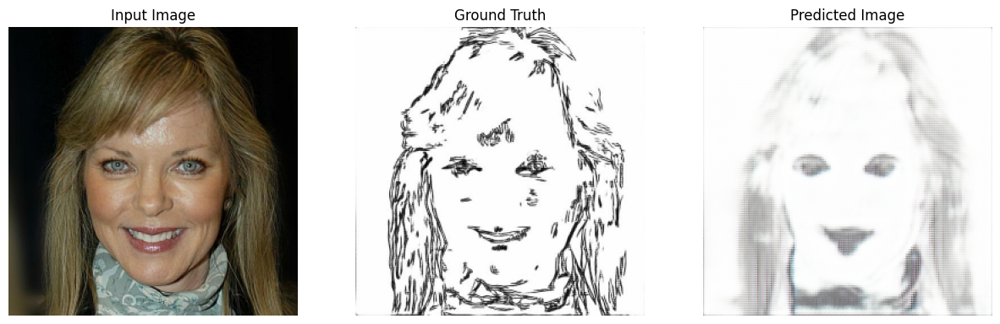

Time taken for epoch 30: 161.37266445159912 sec

Epoch 31/50


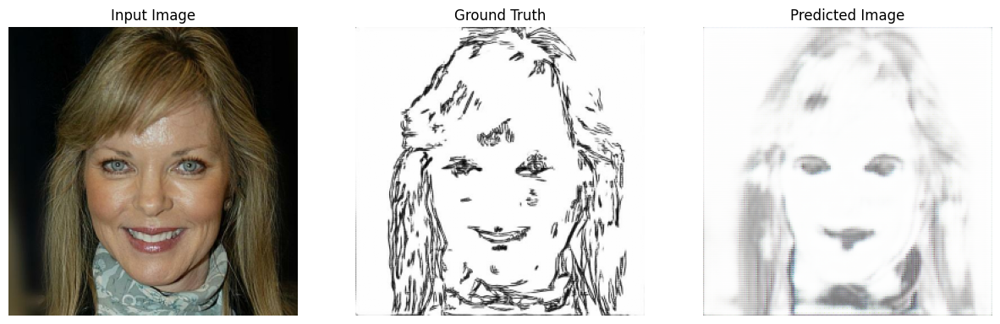

Time taken for epoch 31: 159.1060390472412 sec

Epoch 32/50


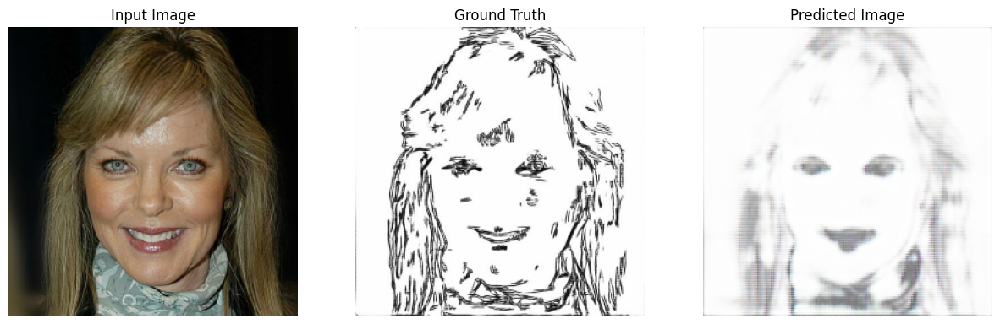

Time taken for epoch 32: 159.53109097480774 sec

Epoch 33/50


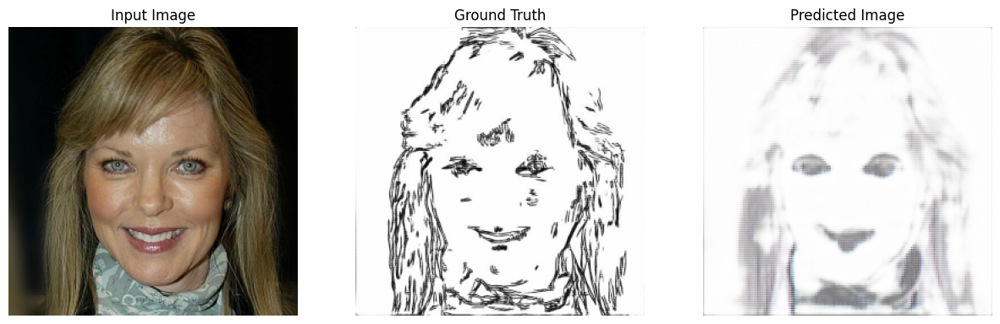

Time taken for epoch 33: 158.7053689956665 sec

Epoch 34/50


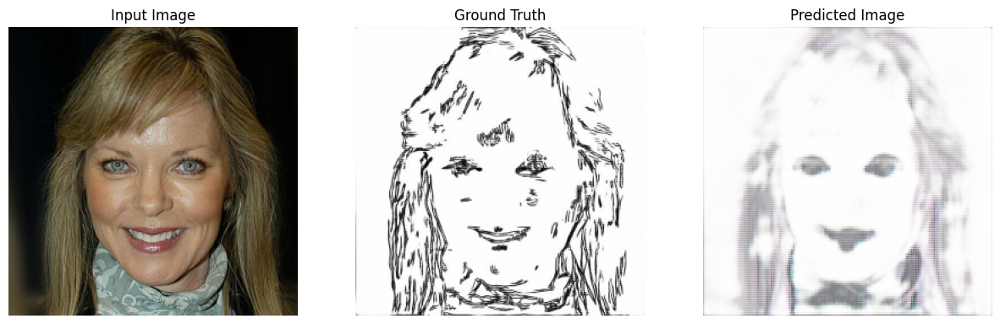

Time taken for epoch 34: 159.08809638023376 sec

Epoch 35/50


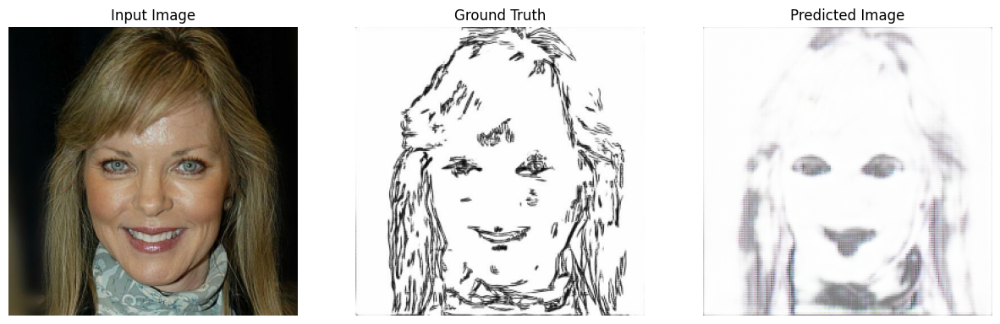

Time taken for epoch 35: 160.44882082939148 sec

Epoch 36/50


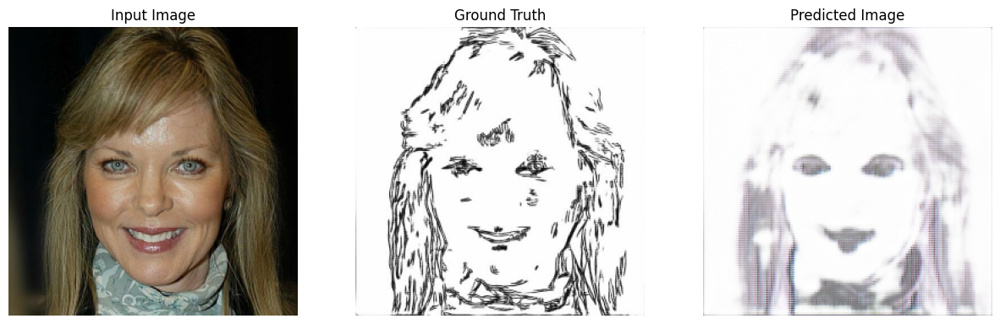

Time taken for epoch 36: 162.44706630706787 sec

Epoch 37/50


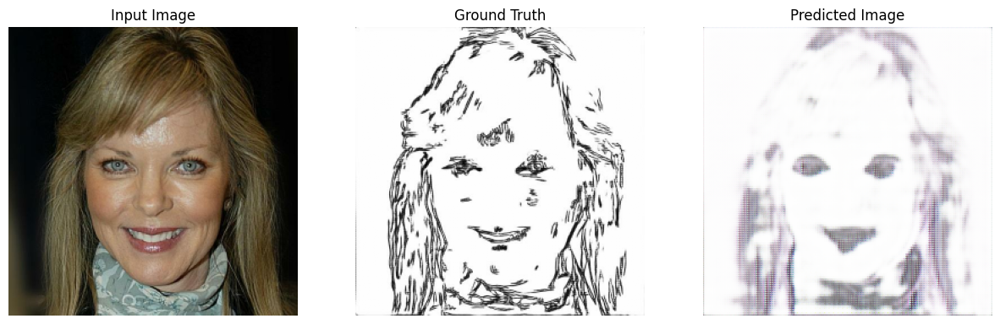

Time taken for epoch 37: 160.2577292919159 sec

Epoch 38/50


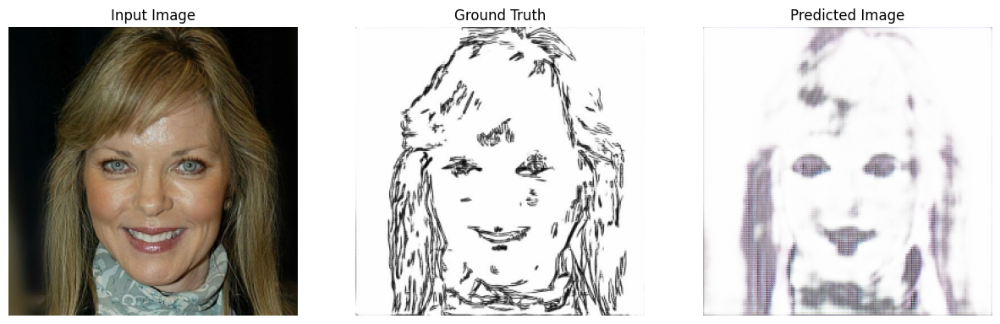

Time taken for epoch 38: 157.91556358337402 sec

Epoch 39/50


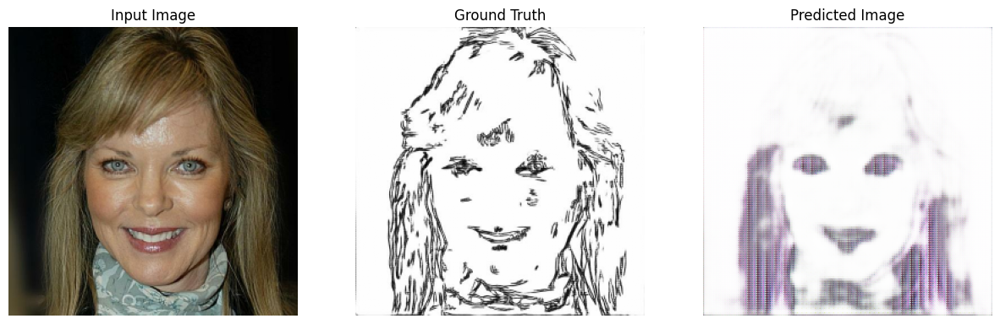

Time taken for epoch 39: 160.32779216766357 sec

Epoch 40/50


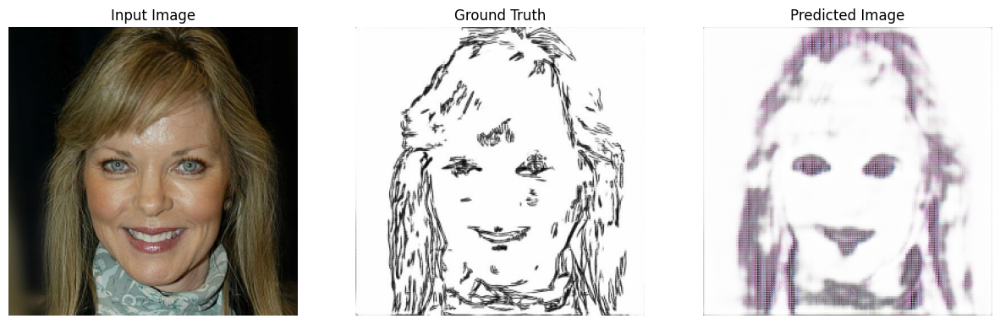

Time taken for epoch 40: 161.11898851394653 sec

Epoch 41/50


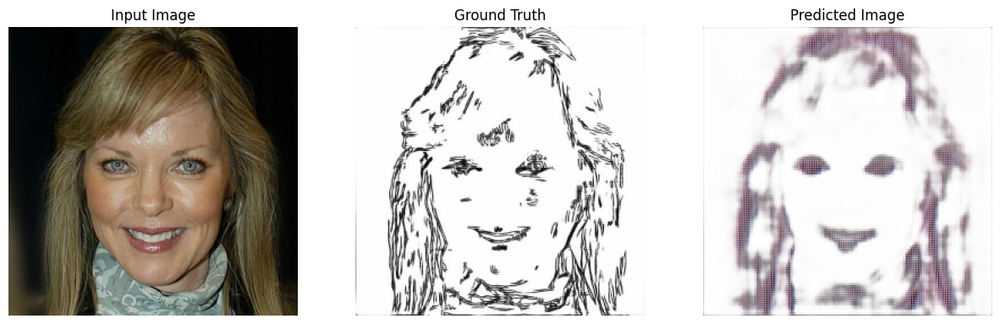

Time taken for epoch 41: 161.66671419143677 sec

Epoch 42/50


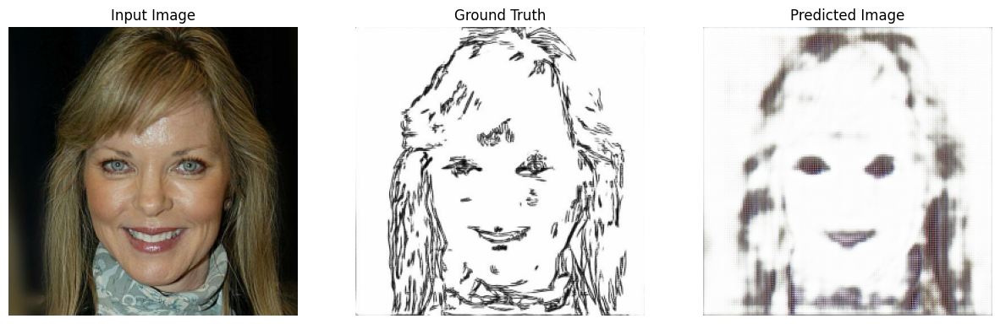

Time taken for epoch 42: 161.38211154937744 sec

Epoch 43/50


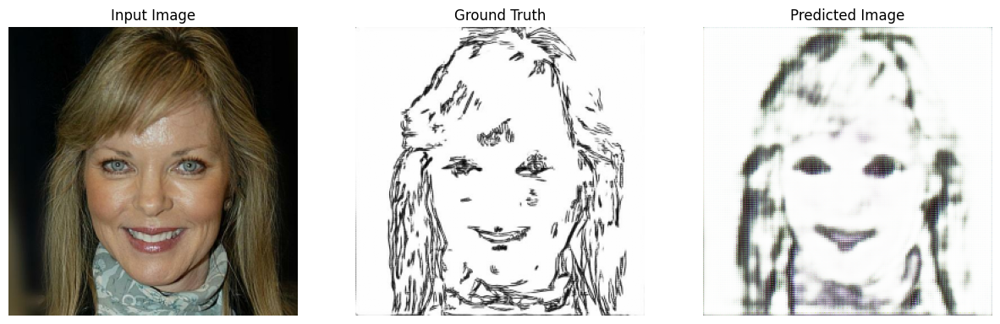

Time taken for epoch 43: 161.24426007270813 sec

Epoch 44/50


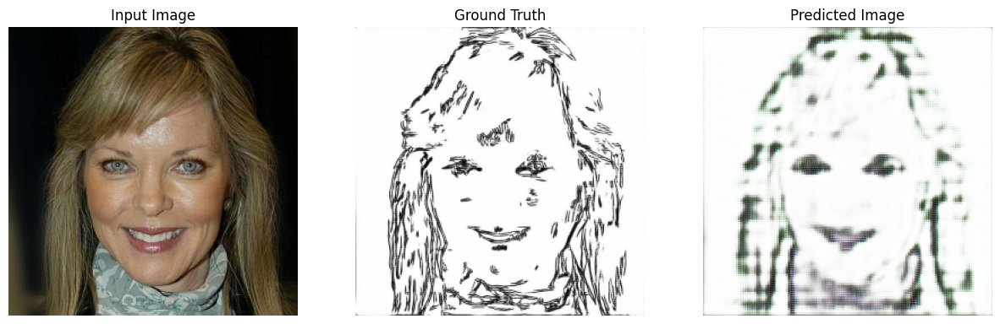

Time taken for epoch 44: 160.9062442779541 sec

Epoch 45/50


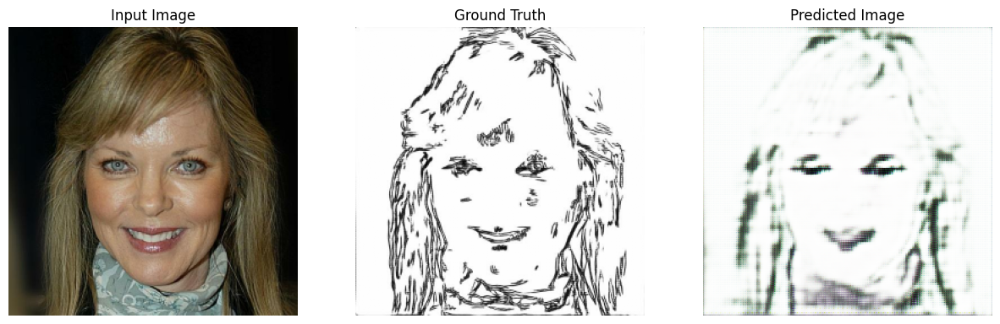

Time taken for epoch 45: 160.75774478912354 sec

Epoch 46/50


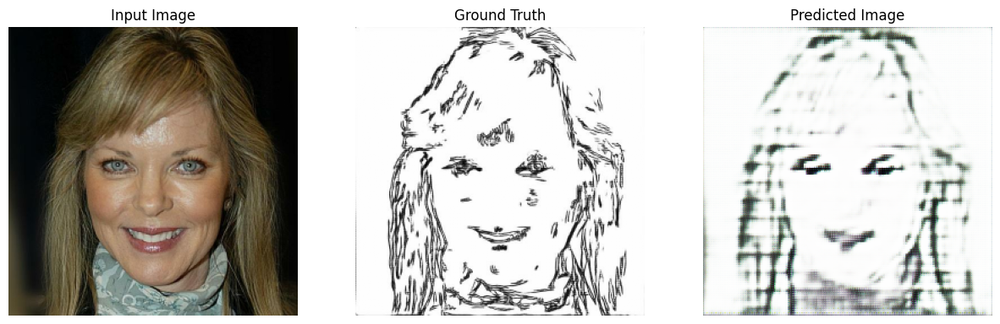

Time taken for epoch 46: 162.0159215927124 sec

Epoch 47/50


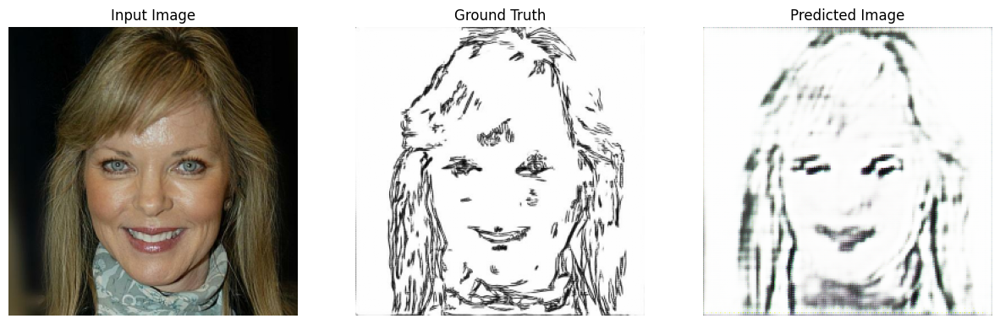

Time taken for epoch 47: 159.78772926330566 sec

Epoch 48/50


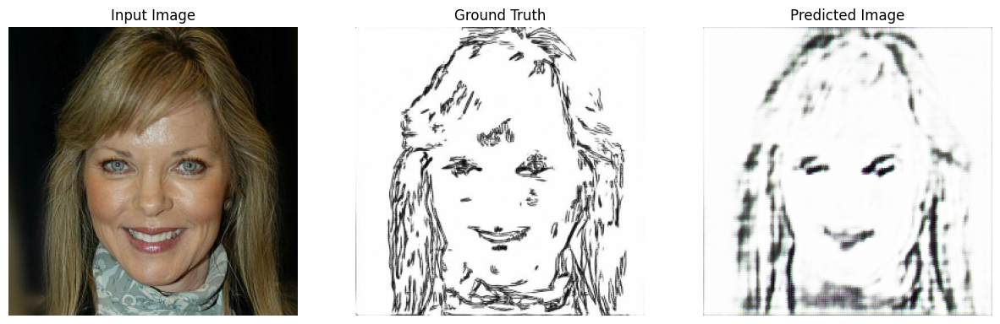

Time taken for epoch 48: 160.945209980011 sec

Epoch 49/50


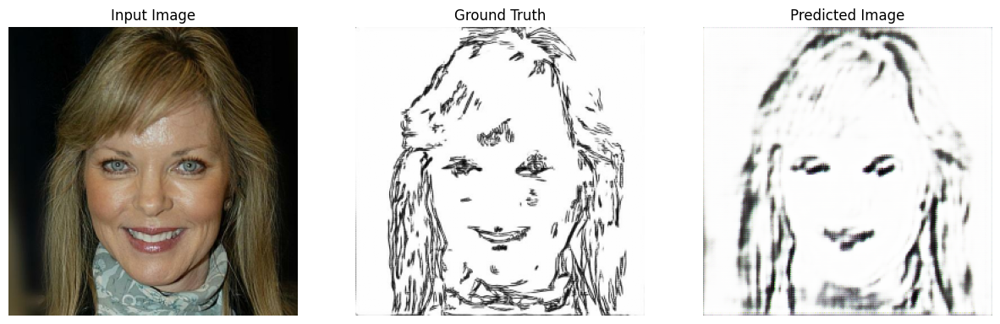

Time taken for epoch 49: 160.45421695709229 sec

Epoch 50/50


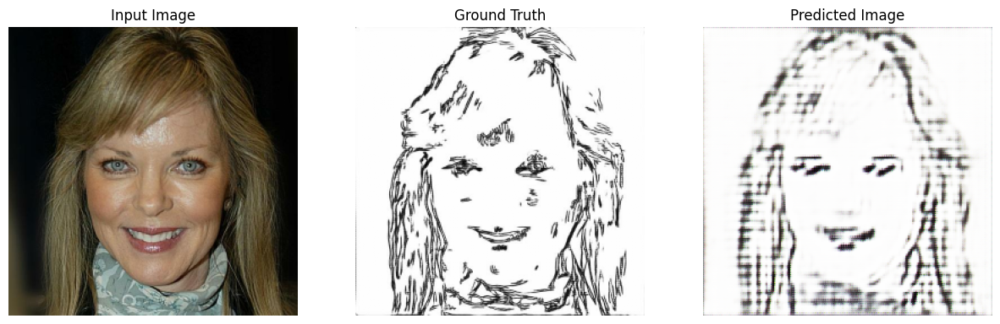

Time taken for epoch 50: 164.12781381607056 sec



In [1]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import os
import time

# Constants
BUFFER_SIZE = 400
BATCH_SIZE = 128
IMG_WIDTH = 256
IMG_HEIGHT = 256
OUTPUT_CHANNELS = 3
LAMBDA = 100
EPOCHS = 50
LIMIT = 1000

# Define directories
train_photos_dir = '/content/drive/MyDrive/train/photos/'
train_sketches_dir = '/content/drive/MyDrive/train/sketches/'
test_photos_dir = '/content/drive/MyDrive/test/photos/'
test_sketches_dir = '/content/drive/MyDrive/test/sketches/'

# Data Processing Functions
def load_image(file_path):
    image = tf.io.read_file(file_path)
    image = tf.image.decode_jpeg(image)

    if tf.shape(image)[-1] == 1:
        image = tf.image.grayscale_to_rgb(image)

    image = tf.cast(image, tf.float32)
    return image

def load_image_pair(photo_file, sketch_file):
    photo_image = load_image(photo_file)
    sketch_image = load_image(sketch_file)
    return photo_image, sketch_image

def preprocess_images(photo_image, sketch_image):
    photo_image = tf.image.resize(photo_image, [IMG_HEIGHT, IMG_WIDTH])
    sketch_image = tf.image.resize(sketch_image, [IMG_HEIGHT, IMG_WIDTH])

    photo_image = (photo_image / 127.5) - 1
    sketch_image = (sketch_image / 127.5) - 1

    return photo_image, sketch_image

def list_matching_files(photo_dir, sketch_dir):
    photo_files = sorted([f for f in os.listdir(photo_dir) if f.endswith('.jpg')])
    sketch_files = sorted([f for f in os.listdir(sketch_dir) if f.endswith('.jpg')])

    matching_files = [(os.path.join(photo_dir, f), os.path.join(sketch_dir, f)) for f in photo_files if f in sketch_files]
    return matching_files[:LIMIT]

# Dataset Preparation
train_matching_files = list_matching_files(train_photos_dir, train_sketches_dir)
test_matching_files = list_matching_files(test_photos_dir, test_sketches_dir)

# Unzip the matching files into separate lists
train_photo_paths, train_sketch_paths = zip(*train_matching_files)
test_photo_paths, test_sketch_paths = zip(*test_matching_files)

# Convert the tuples to lists to avoid TensorFlow errors
train_photo_paths = list(train_photo_paths)
train_sketch_paths = list(train_sketch_paths)
test_photo_paths = list(test_photo_paths)
test_sketch_paths = list(test_sketch_paths)

# Create datasets from the file paths
train_photo_paths = tf.data.Dataset.from_tensor_slices(train_photo_paths)
train_sketch_paths = tf.data.Dataset.from_tensor_slices(train_sketch_paths)
test_photo_paths = tf.data.Dataset.from_tensor_slices(test_photo_paths)
test_sketch_paths = tf.data.Dataset.from_tensor_slices(test_sketch_paths)

# Zip the datasets
train_dataset = tf.data.Dataset.zip((train_photo_paths, train_sketch_paths))
test_dataset = tf.data.Dataset.zip((test_photo_paths, test_sketch_paths))

# Apply preprocessing to the datasets
train_dataset = train_dataset.map(lambda photo, sketch: preprocess_images(load_image(photo), load_image(sketch)),
                                   num_parallel_calls=tf.data.AUTOTUNE).batch(BATCH_SIZE).shuffle(BUFFER_SIZE)

test_dataset = test_dataset.map(lambda photo, sketch: preprocess_images(load_image(photo), load_image(sketch)),
                                 num_parallel_calls=tf.data.AUTOTUNE).batch(BATCH_SIZE)

# Model Definition
def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = keras.Sequential()
    result.add(layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))
    if apply_batchnorm:
        result.add(layers.BatchNormalization())
    result.add(layers.LeakyReLU())
    return result

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = keras.Sequential()
    result.add(layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    result.add(layers.BatchNormalization())
    if apply_dropout:
        result.add(layers.Dropout(0.5))
    result.add(layers.ReLU())
    return result

def Generator():
    inputs = layers.Input(shape=[IMG_HEIGHT, IMG_WIDTH, 3])
    down_stack = [
        downsample(64, 4, apply_batchnorm=False),
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
    ]
    up_stack = [
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4),
        upsample(256, 4),
        upsample(128, 4),
        upsample(64, 4),
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = layers.Conv2DTranspose(OUTPUT_CHANNELS, 4, strides=2, padding='same',
                                  kernel_initializer=initializer, activation='tanh')
    x = inputs
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = layers.Concatenate()([x, skip])
    x = last(x)
    return keras.Model(inputs=inputs, outputs=x)

def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    inp = layers.Input(shape=[IMG_HEIGHT, IMG_WIDTH, 3], name='input_image')
    tar = layers.Input(shape=[IMG_HEIGHT, IMG_WIDTH, 3], name='target_image')
    x = layers.concatenate([inp, tar])
    down1 = downsample(64, 4, False)(x)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)
    zero_pad1 = layers.ZeroPadding2D()(down3)
    conv = layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer, use_bias=False)(zero_pad1)
    batchnorm1 = layers.BatchNormalization()(conv)
    leaky_relu = layers.LeakyReLU()(batchnorm1)
    zero_pad2 = layers.ZeroPadding2D()(leaky_relu)
    last = layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2)
    return tf.keras.Model(inputs=[inp, tar], outputs=last)

generator = Generator()
discriminator = Discriminator()

# Loss and Optimizer
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    total_gen_loss = gan_loss + (LAMBDA * l1_loss)
    return total_gen_loss, gan_loss, l1_loss

def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss

generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# Training Step
@tf.function
def train_step(input_image, target):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)
        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)
        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)
        generator_gradients = gen_tape.gradient(gen_total_loss, generator.trainable_variables)
        discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
        generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
        discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))

    return gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss

# Image Generation
def generate_images(model, test_input, tar, epoch):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(15, 15))
    display_list = [test_input[0], tar[0], prediction[0]]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        plt.title(title[i])
        # getting the pixel values between [0, 1]
        plt.imshow((display_list[i] + 1) / 2)
        plt.axis('off')
    plt.savefig(f'epoch_{epoch}.png')
    plt.show()

# Run Training
def fit(train_ds, epochs, test_ds):
    for epoch in range(epochs):
        start = time.time()
        print(f'Epoch {epoch + 1}/{epochs}')
        for input_image, target in train_ds:
            gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss = train_step(input_image, target)
        for example_input, example_target in test_ds.take(1):
            generate_images(generator, example_input, example_target, epoch)
        print(f'Time taken for epoch {epoch + 1}: {time.time() - start} sec\n')

# Start training
fit(train_dataset, EPOCHS, test_dataset)
